# Food Chunk Analyzer

This is a notebook for the development of the Food Chunk Analyzer, a neural network designed to analyse loose pieces of food products in order to extract their dimensions and evaluate them against production quality requirements.

# Creating, training and evaluating an instance segmentation model

## Import statements

We are going to start by installing the dependencies required for the use of Detectron2, as highlighted in the Detectron2 Tutorial Colab notebook.

In [ ]:
# Let us install the required dependencies.
# NOTE: opencv is needed for the visualization, but already pre-installed on colab.
!pip install pyyaml==5.1 pycocotools>=2.0.1

# gcc >= 5 is required, let us check that this is the case here.
#!gcc --version
#!nvcc --version

# We also need to know which version of torch we are using, if we want to install the pre-built version of Detectron2.
#import torch, torchvision
#print(torch.__version__)

### Building Detectron2

Rather than using a pre-built version of Detectron2 from the Facebook AI public files, we can build Detectron from the git clone hosted on my GitHub account.

In [ ]:
# Build Detectron2 from my forked repository on GitHub.
!python -m pip install 'git+https://github.com/jackbot71/detectron2.git'

  Cloning https://github.com/jackbot71/detectron2.git to /tmp/pip-req-build-w9owxu4w
  Running command git clone -q https://github.com/jackbot71/detectron2.git /tmp/pip-req-build-w9owxu4w
     |████████████████████████████████| 2.2MB 2.8MB/s 
  Created wheel for detectron2: filename=detectron2-0.2.1-cp36-cp36m-linux_x86_64.whl size=4987836 sha256=138ba5c3e61e51e5307bfbcf802a637f62498f526ac59daf8fd706c81b39d36f
  Stored in directory: /tmp/pip-ephem-wheel-cache-povl3vla/wheels/a2/56/f0/1655c24338109e231be40dbe803849200fca724b4116d61ff0
  Created wheel for fvcore: filename=fvcore-0.1.2.post20201013-cp36-none-any.whl size=44196 sha256=545d342c77a406ccec103525a3c2e7923c43f83ba14f2382de5bf3c54ffa37f9
  Stored in directory: /root/.cache/pip/wheels/08/18/28/2fc577c8dd9846a1ba1ab7cf22440abd8067a081b82fa09369
Successfully built detectron2 fvcore
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pi

In [ ]:
# NOTE: the code in this cell if you want to install a pre-built version of Detectron2. DO NOT EXECUTE if you already executed the cell above.
# Install a pre-built version of detectron2, with the corresponding CUDA and torch versions (respectively 10.1 and 1.6).
#!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html

### Import packages and classes required

In [ ]:
# Import detectron2.
import detectron2

# Initialize the detectron2 logger.
from detectron2.utils.logger import setup_logger
setup_logger()

# Import common packages needed, as well as a google colab custom version of cv2.imshow (otherwise cannot use cv2.imshow in colab).
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os, json, cv2, random, glob
from google.colab.patches import cv2_imshow

# Import common detectron2 utilities needed for training and evaluation.
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog, transforms

# Box mode required to properly define the bounding boxes from the annotations, when registering our training and testing datasets.
from detectron2.structures import BoxMode

# Classes required for the training of the network and the registering of data augmentations on the training set.
from detectron2.engine import DefaultTrainer
from detectron2.data import DatasetMapper, build_detection_train_loader

# Classes required to evaluate the network using the COCO metrics.
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

# Useful to visualize inference results from the model.
from detectron2.utils.visualizer import ColorMode


## Test with pre-trained Detectron model

In this part, we will load a config file for a pre-trained Detectron2 model able to recognize the COCO Segmentations, and use it on one of our training images, to see what the model recognizes "out-of-the-box".

In [ ]:
# Initialize detectron2's default config.
cfg = get_cfg()

# Load config from a file, here we chose from the model zoo a COCO Instance Segmentation baseline with a ResNet50+FPN backbone.
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))

# Set a threshold for the detection of the model. Here we will start with a threshold of 50%.
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5

# Load the trained model from detectron2, here trained on 37 COCO Epochs of the train2017 COCO dataset and tested on the val2017 COCO dataset.
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")

# Create a simple end-to-end predictor with the given config that runs on single device for a single input image.
predictor = DefaultPredictor(cfg)


model_final_f10217.pkl: 178MB [00:17, 10.2MB/s]                           


In [ ]:
# Let us read in the first image and use the trained model on it to make predictions.
img = cv2.imread("drive/My Drive/peanut_snack/peanut_snack/train/Picture 1.jpg")
outputs = predictor(img)

/usr/local/lib/python3.6/dist-packages/detectron2/layers/wrappers.py:226: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:766.)
  return x.nonzero().unbind(1)


In [ ]:
# Now let us look at the outputs. See https://detectron2.readthedocs.io/tutorials/models.html#model-output-format for specification.b
print(outputs["instances"].pred_classes)
print(outputs["instances"].pred_boxes)

tensor([], device='cuda:0', dtype=torch.int64)
Boxes(tensor([], device='cuda:0', size=(0, 4)))


Nothing has been detected by the base model, which is understandable considering that it was not trained to recognize peanuts.

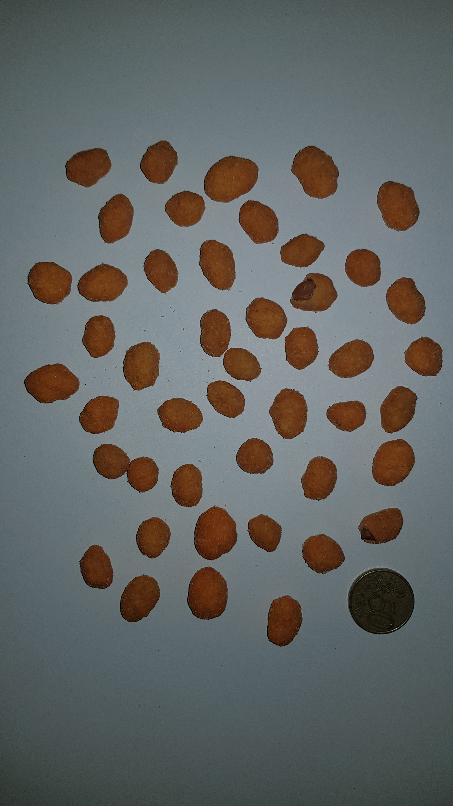

In [ ]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(img[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=0.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

## Registering train and test datasets

Now we need to register our own datasets to be able to train and evaluate Detectron2 with it.

We start by building a function to convert the annotations contained in the json files from the VGG json format to the Detectron2 format.

In [ ]:
def get_snack_dicts(img_dir):
  '''
  This function imports and converts the annotation labels from the VGG json format to the Detectron2 format.

  INPUTS:
  - img_dir: the directory containing the "labels.json" file to be read and converted.

  OUTPUTS:
  - annotation_dicts: the list of dictionaries containing the annotations from the "labels.json" file.
  '''
  json_file = os.path.join(img_dir, "labels.json")

  # Load the VGG JSON file containing our annotations.
  with open(json_file) as f:
    imgs_anns = json.load(f)
    
  # Let us create an empty list that will hold all the annotation dicts.
  annotation_dicts = []

  # Now let us iterate through the image annotation dicts (there is one dict per image) contained in our VGG JSON file.
  for img_id, img_values in enumerate(imgs_anns.values()):

    # Initiate an empty dict that will hold the details and annotations of one image.
    record = {}
  
    # Retrieve the filename from the image annotation dict.
    filename = os.path.join(img_dir, img_values["filename"])

    # The image height and width are not recorded in our VGG JSON file, so we need to retrieve them from the image directly with cv2.imread.
    height, width = cv2.imread(filename).shape[:2]
        
    # Now let us add these details to the record.
    record["file_name"] = filename
    record["image_id"] = img_id
    record["height"] = height
    record["width"] = width
  
    # The annotations are stored under the "regions" key in our VGG JSON file, so we assign them to a more self-explanatory variable.
    annotations = img_values["regions"]
  
    # We also create an empty list that will hold one annotation dict per annotated object on the image.
    objs = []

    # Now we iterate through the annotated objects in the annotations dict.
    for _, annotation in annotations.items():

      # Get the x and y coordinates of the segmentation polygon, in two separate lists.
      px = annotation["shape_attributes"]["all_points_x"]
      py = annotation["shape_attributes"]["all_points_y"]

      # Create a list of (x, y) tuples from the two coordinate lists.
      polygon = [(x, y) for x, y in zip(px, py)]

      # Extract the coordinates from the tuples to have just a list in the format [x1, y1, x2, y2, ...].
      polygon = [p for x in polygon for p in x]

      # Assign the category id (0 for the reference coin, 1 for a food chunk).
      if annotation["region_attributes"]["label"] == "Coated Peanut":
        cat_id = 0
      elif annotation["region_attributes"]["label"] == "Coated Peanut (Broken)":
        cat_id = 1
      else:
        cat_id = 2

      # Create a dict to hold the information about the bounding box, segmentation and label for the annotated object.
      obj = {
        "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
        "bbox_mode": BoxMode.XYXY_ABS,
        "segmentation": [polygon],
        "category_id": cat_id
        }
        
      # Add each object dict to the object dict list.
      objs.append(obj)
    
    # Add the object dict list to the image record.
    record["annotations"] = objs

    # Add the whole image record to the annotation list.
    annotation_dicts.append(record)
  
  return annotation_dicts


Now we need to use that function to actually register our training and test set with Detectron2:

In [ ]:
for d in ['train', 'val']:
  DatasetCatalog.register("peanut_snack_" + d, lambda d=d: get_snack_dicts("drive/My Drive/peanut_snack/peanut_snack/" + d))
  MetadataCatalog.get("peanut_snack_" + d).set(thing_classes=["Coated Peanut", "Coated Peanut (Broken)", "50 Cent Coin"])
peanut_metadata = MetadataCatalog.get("peanut_snack_train")


In [ ]:
# We need to load the annotations for the training set to be able to visualize them on an image.
dataset_dicts = get_snack_dicts('drive/My Drive/peanut_snack/peanut_snack/train')

In [ ]:
# Let us find the position of Picture 1 in dataset_dicts.
for nb, d in enumerate(dataset_dicts):
  print( nb, d['file_name'])

0 drive/My Drive/peanut_snack/peanut_snack/train/Picture 2.jpg
1 drive/My Drive/peanut_snack/peanut_snack/train/Picture 3.jpg
2 drive/My Drive/peanut_snack/peanut_snack/train/Picture 4.jpg
3 drive/My Drive/peanut_snack/peanut_snack/train/Picture 5.jpg
4 drive/My Drive/peanut_snack/peanut_snack/train/Picture 6.jpg
5 drive/My Drive/peanut_snack/peanut_snack/train/Picture 7.jpg
6 drive/My Drive/peanut_snack/peanut_snack/train/Picture 8.jpg
7 drive/My Drive/peanut_snack/peanut_snack/train/Picture 9.jpg
8 drive/My Drive/peanut_snack/peanut_snack/train/Picture 10.jpg
9 drive/My Drive/peanut_snack/peanut_snack/train/Picture 11.jpg
10 drive/My Drive/peanut_snack/peanut_snack/train/Picture 12.jpg
11 drive/My Drive/peanut_snack/peanut_snack/train/Picture 1.jpg
12 drive/My Drive/peanut_snack/peanut_snack/train/Picture 14.jpg
13 drive/My Drive/peanut_snack/peanut_snack/train/Picture 15.jpg
14 drive/My Drive/peanut_snack/peanut_snack/train/Picture 16.jpg
15 drive/My Drive/peanut_snack/peanut_snack/

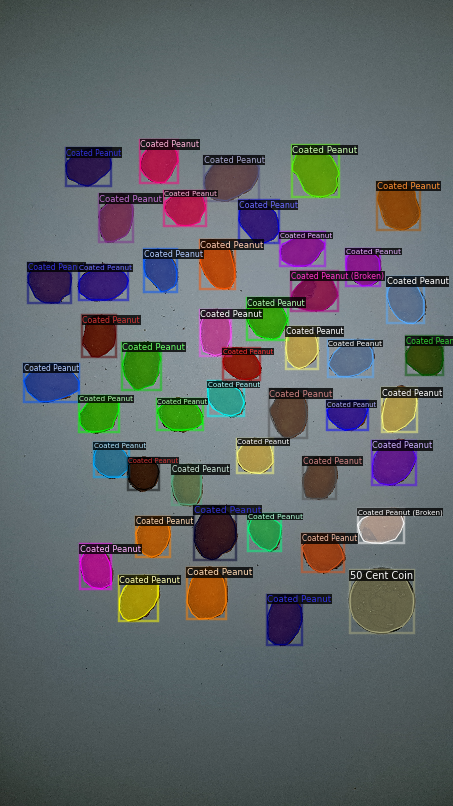

In [ ]:
# Let us visualize Picture 1 along with the annotations to check that everything is loading correctly.
img = cv2.imread("drive/My Drive/peanut_snack/peanut_snack/train/Picture 1.jpg")
visualizer = Visualizer(img[:, :, ::-1], metadata=peanut_metadata, scale=0.2)
out = visualizer.draw_dataset_dict(dataset_dicts[11])
cv2_imshow(out.get_image()[:, :, ::-1])

## Visualizing the composition of the train and test datasets

In [ ]:
count_peanuts_train = 0
count_broken_peanuts_train = 0
count_coins_train = 0

for dict in dataset_dicts:
  for instance in dict["annotations"]:
      if instance["category_id"] == 0:
        count_peanuts_train += 1
      elif instance["category_id"] == 1:
        count_broken_peanuts_train += 1
      else:
        count_coins_train += 1

print("There are {} intact peanut instances in the training dataset.".format(count_peanuts_train))
print("There are {} broken peanut instances in the training dataset.".format(count_broken_peanuts_train))
print("There are {} coin instances in the training dataset.".format(count_coins_train))

There are 486 intact peanut instances in the training dataset.
There are 517 broken peanut instances in the training dataset.
There are 23 coin instances in the training dataset.


In [ ]:
test_dataset_dicts = get_snack_dicts('drive/My Drive/peanut_snack/peanut_snack/val')

In [ ]:
count_peanuts_test = 0
count_broken_peanuts_test = 0
count_coins_test = 0

for dict in test_dataset_dicts:
  for instance in dict["annotations"]:
      if instance["category_id"] == 0:
        count_peanuts_test += 1
      elif instance["category_id"] == 1:
        count_broken_peanuts_test += 1
      else:
        count_coins_test += 1

print("There are {} intact peanut instances in the testing dataset.".format(count_peanuts_test))
print("There are {} broken peanut instances in the testing dataset.".format(count_broken_peanuts_test))
print("There are {} coin instances in the testing dataset.".format(count_coins_test))

There are 254 intact peanut instances in the testing dataset.
There are 40 broken peanut instances in the testing dataset.
There are 7 coin instances in the testing dataset.


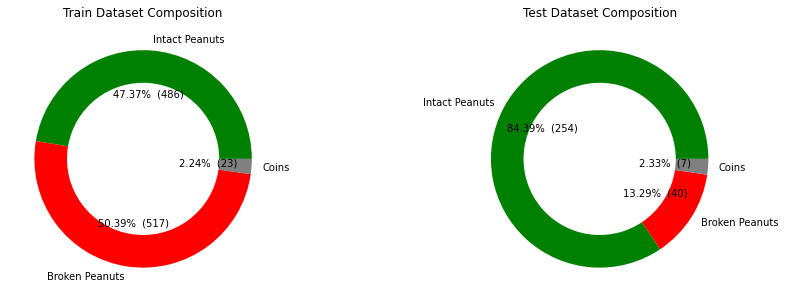

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (15, 5))

train_dataset_composition = [count_peanuts_train, count_broken_peanuts_train, count_coins_train]
test_dataset_composition = [count_peanuts_test, count_broken_peanuts_test, count_coins_test]

ax1.pie(train_dataset_composition, labels=["Intact Peanuts", "Broken Peanuts", "Coins"], colors=["green", "red", "grey"],
        autopct=lambda p : '{:.2f}%  ({:,.0f})'.format(p,p * sum(train_dataset_composition)/100), wedgeprops={"width": 0.3})

ax2.pie(test_dataset_composition, labels=["Intact Peanuts", "Broken Peanuts", "Coins"], colors=["green", "red", "grey"],
        autopct=lambda p : '{:.2f}%  ({:,.0f})'.format(p,p * sum(test_dataset_composition)/100), wedgeprops={"width": 0.3})

ax1.title.set_text("Train Dataset Composition")
ax2.title.set_text("Test Dataset Composition")

plt.show()

## Training the model

Now we can get serious, and start training our network to detect the 3 classes that can be found on our pictures: the peanuts, the broken peanuts, and the 50 cent coin used as a reference for the dimensions.

In [ ]:
# Create the configuration of the model.

# Initialize detectron2's default config.
cfg = get_cfg()
# Load config from a file.
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
# Define the training dataset.
cfg.DATASETS.TRAIN = ("peanut_snack_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
# Get initial weights from the pre-trained model.
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
# Set the model to process images per batch of 2.
cfg.SOLVER.IMS_PER_BATCH = 2
# Pick a base learning rate (it will be adapted throughout the training).
cfg.SOLVER.BASE_LR = 0.00025
# Pick the number of iterations (or epochs) for the training.
cfg.SOLVER.MAX_ITER = 1500
# Pick the batch size per image (i.e. the size of the picture loaded per batch). 512 is the default, but as we are training the model on Colab, we should lower that to 128 make training faster.
# This can decrease the accuracy, but as we will see later, this is still more than enough for this application.
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
# Register the number of classes, here 3: peanuts, broken peanuts, and 50 cent coin.
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3

# Modify the training data loader to include data augmentations. 
dataloader = build_detection_train_loader(cfg,
   mapper=DatasetMapper(cfg, is_train=True, augmentations=[
      transforms.RandomBrightness(0.9, 1.1),
      transforms.RandomFlip(prob=0.5),
      transforms.RandomCrop("absolute", (640, 640))
   ]))

# Set directory for the output of the training.
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
# Set the default trainer, and to start from scratch.
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)

# Train the model.
trainer.train()

[10/12 17:35:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [RandomBrightness(intensity_min=0.9, intensity_max=1.1), RandomFlip(prob=0.5), RandomCrop(crop_type='absolute', crop_size=(640, 640))]
[10/12 17:35:33 d2.data.build]: Removed 0 images with no usable annotations. 23 images left.
[10/12 17:35:33 d2.data.common]: Serializing 23 elements to byte tensors and concatenating them all ...
[10/12 17:35:33 d2.data.common]: Serialized dataset takes 0.40 MiB
[10/12 17:35:33 d2.data.build]: Using training sampler TrainingSampler
[10/12 17:35:34 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kerne

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (12, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (12,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (3, 256, 1, 1) 

[10/12 17:35:40 d2.engine.train_loop]: Starting training from iteration 0
[10/12 17:36:14 d2.utils.events]:  eta: 0:39:23  iter: 19  total_loss: 2.841  loss_cls: 1.344  loss_box_reg: 0.7088  loss_mask: 0.693  loss_rpn_cls: 0.02909  loss_rpn_loc: 0.06293  time: 1.6037  data_time: 0.1097  lr: 4.9953e-06  max_mem: 5297M
[10/12 17:36:45 d2.utils.events]:  eta: 0:38:59  iter: 39  total_loss: 2.709  loss_cls: 1.242  loss_box_reg: 0.6515  loss_mask: 0.6808  loss_rpn_cls: 0.02144  loss_rpn_loc: 0.05604  time: 1.5972  data_time: 0.0142  lr: 9.9902e-06  max_mem: 5297M
[10/12 17:37:18 d2.utils.events]:  eta: 0:38:54  iter: 59  total_loss: 2.486  loss_cls: 1.038  loss_box_reg: 0.6937  loss_mask: 0.6517  loss_rpn_cls: 0.01173  loss_rpn_loc: 0.05249  time: 1.6040  data_time: 0.0184  lr: 1.4985e-05  max_mem: 5297M
[10/12 17:37:50 d2.utils.events]:  eta: 0:38:36  iter: 79  total_loss: 2.227  loss_cls: 0.868  loss_box_reg: 0.684  loss_mask: 0.6101  loss_rpn_cls: 0.01443  loss_rpn_loc: 0.05283  time: 1.

In [ ]:
# Look at training curves in tensorboard.
%load_ext tensorboard
%tensorboard --logdir ./drive/'My Drive'/peanut_snack

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
# Change the configuration for inference using the model we just trained.
cfg.MODEL.WEIGHTS = os.path.join("./drive/My Drive/peanut_snack/Train1to23_1500iter_12_10", "model_final.pth")
# Set a threshold for the inference.
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
# Set the default predictor for the model.
predictor = DefaultPredictor(cfg)

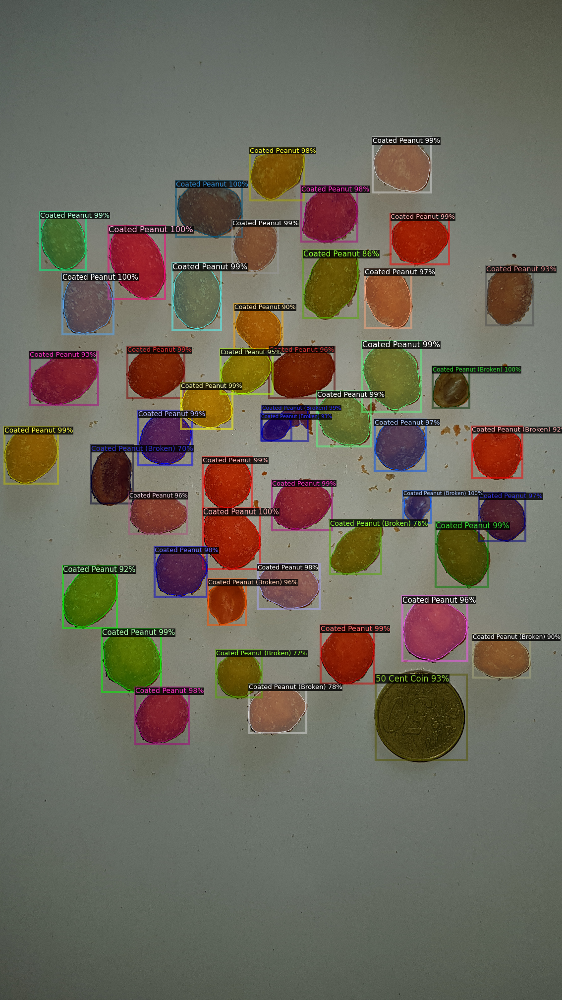

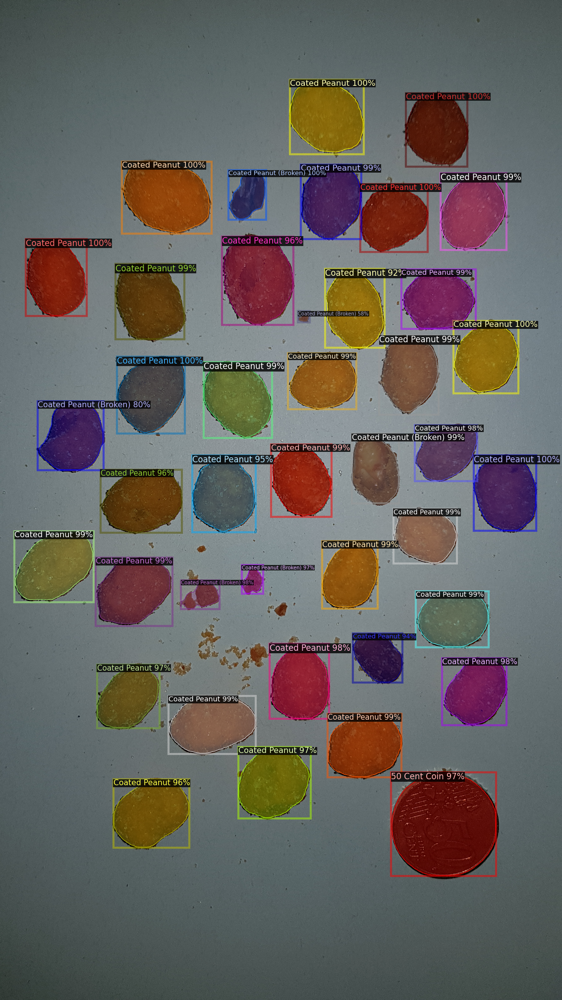

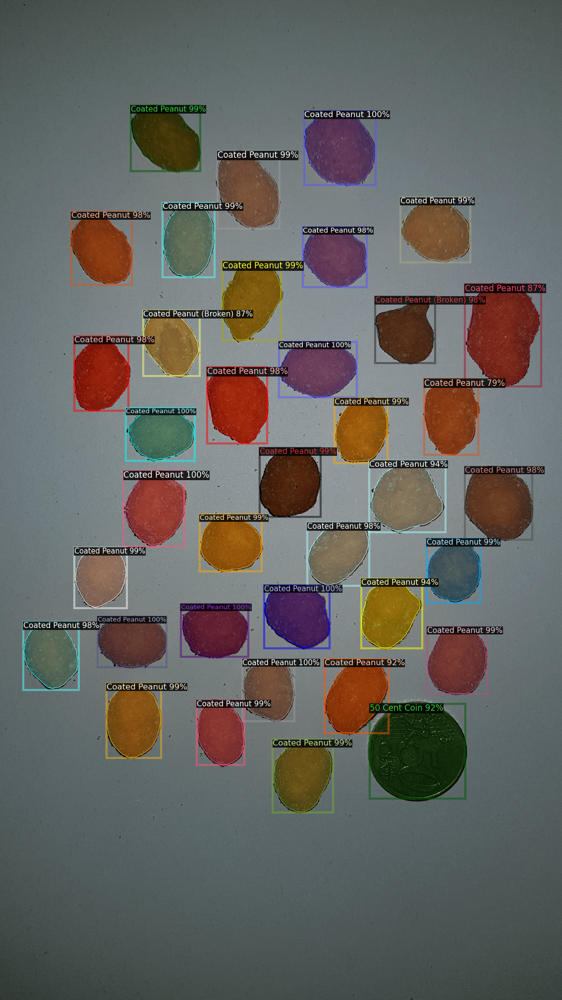

In [ ]:
# Now let us visualize the results for 3 images taken at random from our testing dataset.
dataset_dicts = get_snack_dicts("drive/My Drive/peanut_snack/peanut_snack/val")
for d in random.sample(dataset_dicts, 3):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=peanut_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

## Evaluating the model

In order to judge of the performance of our neural network, we now need to evaluate it on our testing set. To do that, since we are using the ResNET for instance segmentation, we will use the COCOEvaluator from Detectron2 to determine the Average Precision (AP).

In [ ]:
# NOTE: the code in this cell is only needed to load a model previously saved (DO NOT EXECUTE if you just trained a model and want to evaluate it).
# First let use build our configuration back, and load the weights from the model previously saved.
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("peanut_snack_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = os.path.join("./drive/My Drive/peanut_snack/Train1to23_300iter_12_10", "model_final.pth")  # path to the model we just trained
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 1200
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3


dataloader = build_detection_train_loader(cfg,
   mapper=DatasetMapper(cfg, is_train=True, augmentations=[
      transforms.RandomBrightness(0.9, 1.1),
      transforms.RandomFlip(prob=0.5),
      transforms.RandomCrop("absolute", (640, 640))
   ]))

# Let us set the testing threshold for detection.
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=True)



[10/13 10:04:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [RandomBrightness(intensity_min=0.9, intensity_max=1.1), RandomFlip(prob=0.5), RandomCrop(crop_type='absolute', crop_size=(640, 640))]
[10/13 10:04:40 d2.data.build]: Removed 0 images with no usable annotations. 23 images left.
[10/13 10:04:40 d2.data.common]: Serializing 23 elements to byte tensors and concatenating them all ...
[10/13 10:04:40 d2.data.common]: Serialized dataset takes 0.40 MiB
[10/13 10:04:40 d2.data.build]: Using training sampler TrainingSampler
[10/13 10:04:40 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kerne

In [ ]:
# Now let us evaluate the predictions of the model using the COCOEvaluator class to retrieve the COCO metrics.
evaluator = COCOEvaluator("peanut_snack_val", cfg, False, output_dir="./evaluation/")
val_loader = build_detection_test_loader(cfg, "peanut_snack_val")
results = inference_on_dataset(trainer.model, val_loader, evaluator)
print(results)

[10/13 09:17:00 d2.data.common]: Serializing 7 elements to byte tensors and concatenating them all ...
[10/13 09:17:00 d2.data.common]: Serialized dataset takes 0.11 MiB
[10/13 09:17:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[10/13 09:17:00 d2.evaluation.evaluator]: Start inference on 7 images
[10/13 09:17:17 d2.evaluation.evaluator]: Total inference time: 0:00:04.379858 (2.189929 s / img per device, on 1 devices)
[10/13 09:17:17 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.137422 s / img per device, on 1 devices)
[10/13 09:17:17 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[10/13 09:17:17 d2.evaluation.coco_evaluation]: Saving results to ./evaluation/coco_instances_results.json
[10/13 09:17:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE

Because we need to decide which threshold to use, as well as which model (depending on the amount of iterations in the training), we are going to evaluate and record the Average Precision (https://cocodataset.org/#detection-eval)  for each version of the model (i.e. number of training iterations) and over a range of different detection thresholds, from 0.5 to 0.9, to see how the choice of the threshold and the number of training iterations impacts the quality of the model output.

In [ ]:
# Create an empty list to store the ordered dict created by the evaluator for a specific model.
result_threshold_opti = []

# Iterate over threshold values from 0.5 to 0.9 by increments of 0.05.
for threshold in [x / 100 for x in range(50, 95, 5)]:

  # Set the model detection threshold.
  cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = threshold

  # Refresh the model trainer (as this is what is used inside the COCOEvaluator class).
  os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
  trainer = DefaultTrainer(cfg)
  trainer.resume_or_load(resume=True)

  # Evaluate the results for that specific threshold, and append them to the list.
  evaluator = COCOEvaluator("peanut_snack_val", cfg, False, output_dir="./evaluation/")
  val_loader = build_detection_test_loader(cfg, "peanut_snack_val")
  results = inference_on_dataset(trainer.model, val_loader, evaluator)
  result_threshold_opti.append(results)
  print(results)

[10/13 10:05:12 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

In [ ]:
# Let us save the results for a model in a json file, that I can then stored on the drive.
with open('results_threshold_opti.json', 'w') as f:
    json.dump(result_threshold_opti, f)

Once the above procedure has been repeated for all models (300, 600, 900, 1200 and 1500 training iterations), let us retrieve the results from the drive, aggregate them together in a pandas dataframe, and plot them to decide which model / detection threshold combination to choose for our quality control application.

In order to avoid code repetition, we create a function for that purpose, as we will have to retrieve several metrics: AP, AP for intact peanuts, AP for broken peanuts, and AP for coins.

In [ ]:
def extract_metric(metric, test_dirs="drive/My Drive/peanut_snack/Test*"):
  '''
  This function retrieves the metrics contained in the json files generated by the COCOEvaluator, and saved in different folders (1 folder / model).

  INPUTS:
  - test_dirs: the string to be passed to glob to retrieve the paths to the test folders.
  - metric: the name of the metric to be retrieved from the bbox and segm results.

  OUTPUTS:
  - bbox_AP_df: a dataframe containing the metrics (calculated for the bounding box) for the different models in the test folders.
  - segm_AP_df: a dataframe containing the metrics (calculated for the segmentation) for the different models in the test folders.
  '''
  
  # Get the list of folder names containing the evaluation results.
  test_dirs = glob.glob("drive/My Drive/peanut_snack/Test*")
  
  # Create two empty dataframes to hold the results for bounding box and segmentation.
  bbox_AP_df = pd.DataFrame()
  segm_AP_df = pd.DataFrame()
  
  # Iterate through the folders to retrieve the results for each model.
  for dir in test_dirs:
    
    # Create empty lists to contain the results for the various thresholds.
    bbox_AP_list = []
    segm_AP_list = []
    
    # Load the resulst from the json file.
    json_file = os.path.join(dir, "results_threshold_opti.json")
    
    with open(json_file) as f:
      results = json.load(f)
      
    # Extract the Average Precision for bounding box and segmentation, and append them to the lists.
    for item in results:

      try:
        bbox_AP_list.append(item['bbox'][metric])
      except:
        bbox_AP_list.append(np.nan)
      
      try:
        segm_AP_list.append(item['segm'][metric])
      except:
        segm_AP_list.append(np.nan)
      
    # Add the lists as series to the dataframes.
    bbox_AP_df[dir] = bbox_AP_list
    segm_AP_df[dir] = segm_AP_list
    
  # Rename the index to be the corresponding detection threshold.
  bbox_AP_df.index = [x / 100 for x in range(50, 95, 5)]
  # Rename the columns to only have the number of iterations.
  bbox_AP_df.columns = bbox_AP_df.columns.str.split("_").str[2]
  
  # Do the same operations for the segmentation dataframe.
  segm_AP_df.index = [x / 100 for x in range(50, 95, 5)]
  segm_AP_df.columns = segm_AP_df.columns.str.split("_").str[2]

  return bbox_AP_df, segm_AP_df

In [ ]:
bbox_AP_df, segm_AP_df = extract_metric("AP")

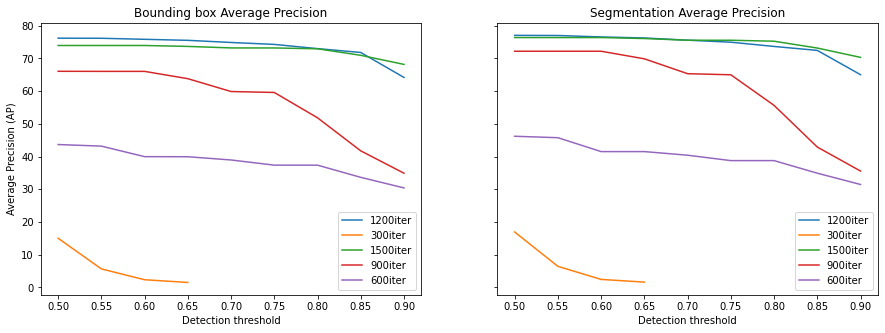

In [ ]:
# Plot the results
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5), sharey=True)
bbox_AP_df.plot(ax=ax1)
segm_AP_df.plot(ax=ax2)

ax1.title.set_text("Bounding box Average Precision")
ax2.title.set_text("Segmentation Average Precision")

ax1.set_xlabel("Detection threshold")
ax2.set_xlabel("Detection threshold")

ax1.set_ylabel("Average Precision (AP)")

plt.show()

From the results, it seems that the model trained on 1200 iterations is actually the best candidate, whereas the model trained on 1500 iterations is performing similarly or a bit worse. This could by explained by an overfitting of the model trained beyond 1200 iterations.

Regarding the detection threshold, it seems that on average, over our testing set, increasing the threshold is not improving the precision, but rather decreasing it, as fewer predictions are output by the model. We should then choose the model trained on 1200 iterations, with a threshold of 0.5, for our quality control application.

In [ ]:
bbox_AP_peanut_df, segm_AP_peanut_df = extract_metric("AP-Coated Peanut")

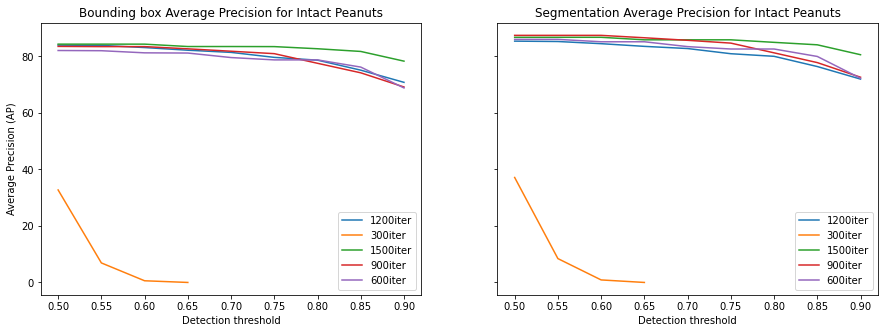

In [ ]:
# Plot the results
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5), sharey=True)
bbox_AP_peanut_df.plot(ax=ax1)
segm_AP_peanut_df.plot(ax=ax2)

ax1.title.set_text("Bounding box Average Precision for Intact Peanuts")
ax2.title.set_text("Segmentation Average Precision for Intact Peanuts")

ax1.set_xlabel("Detection threshold")
ax2.set_xlabel("Detection threshold")

ax1.set_ylabel("Average Precision (AP)")

plt.show()

In [ ]:
bbox_AP_peanut_broken_df, segm_AP_peanut_broken_df = extract_metric("AP-Coated Peanut (Broken)")

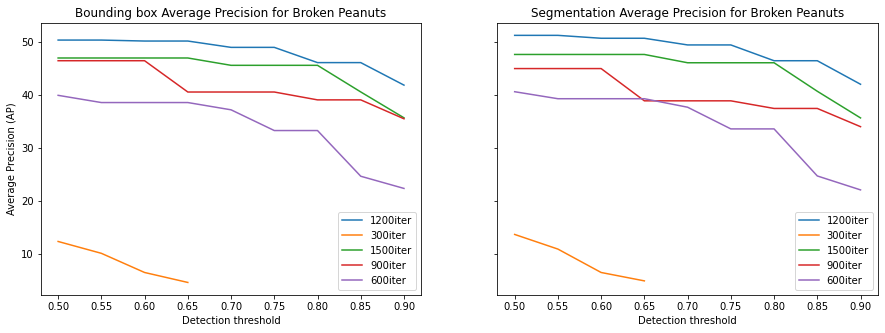

In [ ]:
# Plot the results
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5), sharey=True)
bbox_AP_peanut_broken_df.plot(ax=ax1)
segm_AP_peanut_broken_df.plot(ax=ax2)

ax1.title.set_text("Bounding box Average Precision for Broken Peanuts")
ax2.title.set_text("Segmentation Average Precision for Broken Peanuts")

ax1.set_xlabel("Detection threshold")
ax2.set_xlabel("Detection threshold")

ax1.set_ylabel("Average Precision (AP)")

plt.show()

In [ ]:
bbox_AP_coin_df, segm_AP_coin_df = extract_metric("AP-50 Cent Coin")

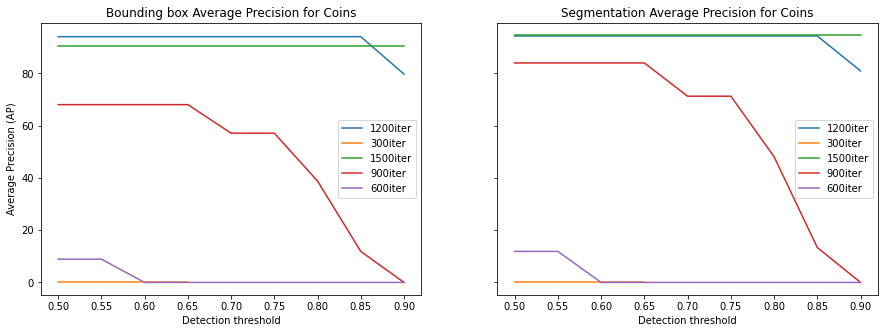

In [ ]:
# Plot the results
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5), sharey=True)
bbox_AP_coin_df.plot(ax=ax1)
segm_AP_coin_df.plot(ax=ax2)

ax1.title.set_text("Bounding box Average Precision for Coins")
ax2.title.set_text("Segmentation Average Precision for Coins")

ax1.set_xlabel("Detection threshold")
ax2.set_xlabel("Detection threshold")

ax1.set_ylabel("Average Precision (AP)")

plt.show()

# Processing the outputs for quality evaluation

## Loading the model for inference with cpu

In [ ]:
# Load the model and use it with a cpu configuration
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
# Let us load the model trained on 1200 iterations, as explained in the previous section.
cfg.MODEL.WEIGHTS = os.path.join("./drive/My Drive/peanut_snack/Train1to23_1200iter_07_10", "model_final.pth")  # path to the model we just trained
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 1200
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3
# Let us choose a detection threshold of 0.5, as explained previously.
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.DEVICE='cpu'

predictor = DefaultPredictor(cfg)

For the purpose of development, we will focus for now on the first image of the testing set, Picture 24. Let's visualize the picture, as well as the output from the model we loaded.

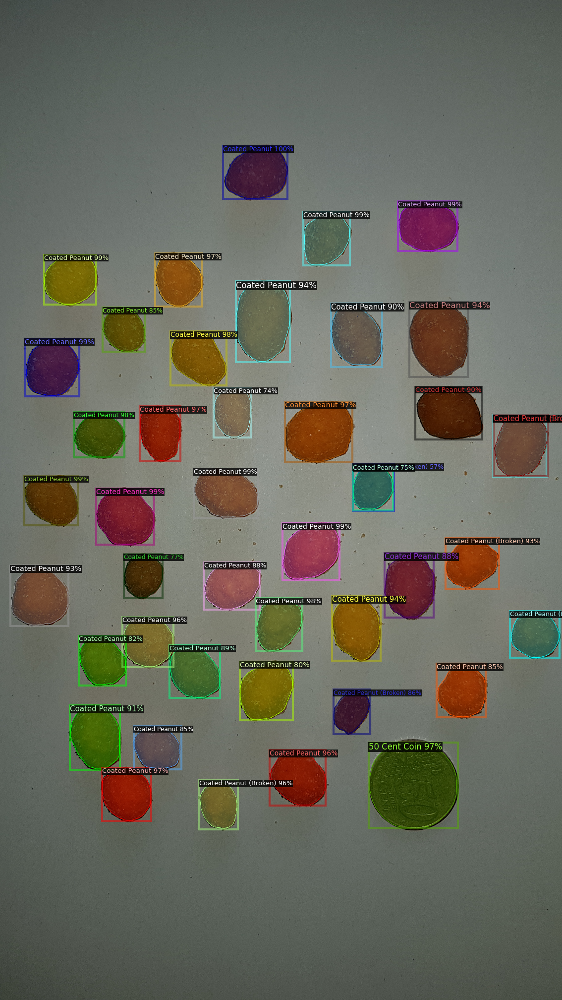

In [ ]:
dataset_dicts = get_snack_dicts("drive/My Drive/peanut_snack/peanut_snack/val")
 
im = cv2.imread("drive/My Drive/peanut_snack/peanut_snack/val/Picture 24.jpg")
outputs = predictor(im)  
v = Visualizer(im[:, :, ::-1],
               metadata=peanut_metadata, 
               scale=0.5, 
               instance_mode=ColorMode.IMAGE_BW)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

## Extracting the dimension reference (coin)

The first step to extract the dimension distribution of the peanut on our picture, is to determine the pixel to mm ratio using the reference that we have on it. In our case, the reference is a 50 cent Euro coin that we included in all pictures.

In [ ]:
# Read the picture that we want to analyze.
im = cv2.imread("drive/My Drive/peanut_snack/peanut_snack/val/Picture 24.jpg")
# Create predictions for the masks using the loaded model.
outputs = predictor(im)

# Retrieve the masks detected, and the associated classes, in the model output.
masks = np.array(outputs['instances'].pred_masks.cpu()).astype('uint8')
classes = np.array(outputs['instances'].pred_classes.cpu()).astype('uint8')

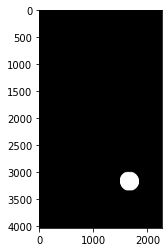

In [ ]:
# Find and display the mask of the coin on the picture (coin is class number 2 in our metadata).
im = masks[classes == 2][0]

# Convert the mask from 0 and 1 to 0 and 255.
im_255 = im*255
# And then to a color picture.
im_color = cv2.cvtColor(im_255, cv2.COLOR_GRAY2BGR)

# Display the mask.
plt.imshow(im_color)
plt.show()

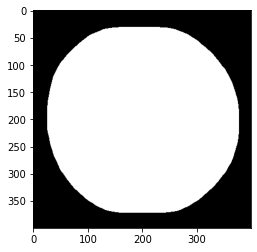

In [ ]:
# The image is already binary here, so we can focus on finding the contours.
contours = cv2.findContours(im_255, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)[0][0]

# We can then extract the moment and the coordinates of the centroid.
M = cv2.moments(contours)
cx = int(M['m10']/M['m00'])
cy = int(M['m01']/M['m00'])

# And use that to crop a 400 px square around the center of the coin.
im_cropped = im_color[cy-200:cy + 200, cx-200:cx +200]

plt.imshow(im_cropped)
plt.show()

In [ ]:
# Since we now that the coin should be a circle, let's find the best enclosing circle using openCV.
(x, y), radius = cv2.minEnclosingCircle(contours)
center = (int(x), int(y))
radius = int(radius)
# To display it on our cropped image, we need to recalculate the coordinates of the center.
center_cropped = (int(x) - cx + 200, int(y) - cy + 200)
print(center, center_cropped, radius)

(1666, 3162) (200, 198) 181


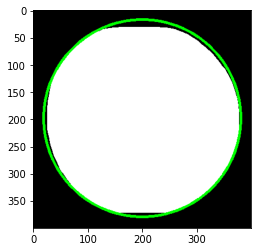

In [ ]:
# Display the cropped coin mask and the best enclosing circle calculated.
im_cropped_circle = cv2.circle(im_cropped, center_cropped, radius, (0, 255, 0), 3)
plt.imshow(im_cropped_circle)
plt.show()

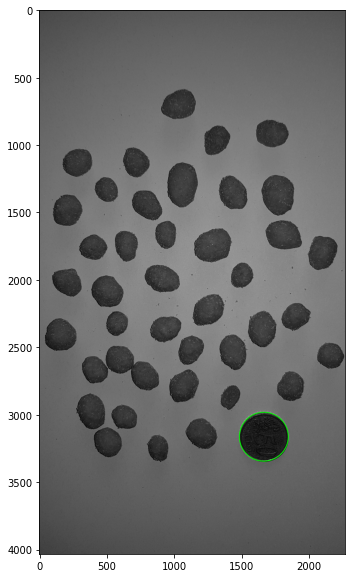

In [ ]:
# To check everything worked correctly, let's draw the circle on the original image, in black and white.
img = cv2.cvtColor(cv2.imread("drive/My Drive/peanut_snack/peanut_snack/val/Picture 24.jpg", 0),cv2.COLOR_GRAY2BGR)

plt.figure(figsize=(20,10))
plt.imshow(cv2.circle(img, center, radius, (0, 255, 0), 5))
plt.show()

That looks like a very good fit!

Now let us use the 50 cent coin radius to determine the ratio of px to mm of the picture. A 50 cent Euro coin has a diameter of 24,25 mm (source: https://ec.europa.eu/info/business-economy-euro/euro-area/euro-coins-and-notes/euro-coins/common-sides-euro-coins_en#:~:text=%3A%20interrupted%2Fmilled.-,50%20cent,Weight%3A%207.80g.).

In [ ]:
ratio_px2mm = 24.25/(radius*2)
print(ratio_px2mm)

0.06698895027624309


## Extracting the dimensions of a peanut

Now that we know the ratio between a pixel on the picture and real life dimensions, let us measure the mask of a peanut on the picture.

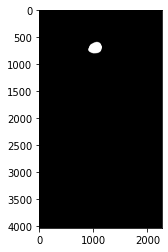

In [ ]:
# Find and display the mask of the first peanut on the picture.
im = masks[classes == 0][0]

# Convert the mask from 0 and 1 to 0 and 255.
im_255 = im*255
# And then to a color picture.
im_color = cv2.cvtColor(im_255, cv2.COLOR_GRAY2BGR)

# Display the mask.
plt.imshow(im_color)
plt.show()

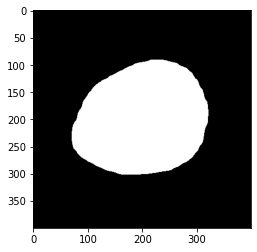

In [ ]:
# The image is already binary here, so we can focus on finding the contours.
contours = cv2.findContours(im_255, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)[0][0]

# We can then extract the moment and the coordinates of the centroid.
M = cv2.moments(contours)
cx = int(M['m10']/M['m00'])
cy = int(M['m01']/M['m00'])

# And use that to crop a 400 px square around the center of the coin.
im_cropped = im_color[cy-200:cy + 200, cx-200:cx +200]

plt.imshow(im_cropped)
plt.show()

In [ ]:
# We proceed similarly to the coin, but we fit an ellipse, as we don't expect the peanuts to be perfectly round.
ellipse = cv2.fitEllipse(contours)
ellipse_cropped = ((ellipse[0][0]-cx+200, ellipse[0][1]-cy+200), ellipse[1], ellipse[2])
print(ellipse, ellipse_cropped)

((1039.344482421875, 700.3547973632812), (204.0324249267578, 254.31211853027344), 68.66455841064453) ((201.344482421875, 201.35479736328125), (204.0324249267578, 254.31211853027344), 68.66455841064453)


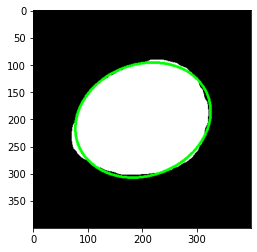

In [ ]:
im_cropped_ellipse = cv2.ellipse(im_cropped, ellipse_cropped, (0,255,0) ,3)
plt.imshow(im_cropped_ellipse)
plt.show()

Finally, let's retrieve the ellipse dimensions, and convert them using the ratio previously calculated to extract the real life length and width of the peanut.

In [ ]:
# Determine the dimensions of the peanut.
length_peanut = max(ellipse[1]) * ratio_px2mm
width_peanut = min(ellipse[1]) * ratio_px2mm
print(length_peanut, width_peanut)

17.036101862870527 13.66791796815988


## Putting it all together

Now, we have all the elements to build the quality control application. We need to put all of these elements together in a script that:

1.   Uses the trained model to detect the masks of the items on the picture, and classifies them into peanut, broken peanut and reference coin.

2.   Extracts the mask of the reference coin, and uses it to determine the pixel to mm ratio of the picture analyzed.

3.   Iterates through the intact peanut masks to retrieve the dimensions in mm of each intact peanut detected, and store it in a list.

3.   Uses that list and the other information to produce a useful display that shows the number of peanuts detected, the proportion of broken peanuts, and a graph showing the distribution of dimensions of the intact peanuts.





In [ ]:
def find_ratio(masks, classes):
  '''
  This function uses the output of the model to determine the pixel to mm ratio of the picture analyzed.

  INPUTS:
  - masks: ndarray containing the masks of the N instances detected on the image by the model.
  - classes: ndarray containing the classes of all the instances detected on the image.

  OUPTUTS:
  - ratio_px2mm: float, the pixel to mm ratio of the picture analyzed.
  '''

  # Find the mask of the coin on the picture.
  im = masks[classes == 2][0]
  
  # Convert the mask from an array with values of 0 and 1 to values of 0 and 255.
  im_255 = im*255

  # Find the contour of the coin mask on the binary picture.
  contour = cv2.findContours(im_255, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)[0][0]

  # Use the contour to determine the diameter of the coin in pixels on the picture.
  px_diameter = int(cv2.minEnclosingCircle(contour)[1]) * 2
  
  # Use the real dimensions of the coin and the diameter in pixels to determine the ratio.
  ratio_px2mm = 24.25/px_diameter

  return ratio_px2mm


In [ ]:
# Test our function.
find_ratio(masks, classes)

0.06698895027624309

In [ ]:
def measure_peanut_mask(masks, classes, ratio_px2mm, instance_nb):
  '''
  This function uses the output of the model to measure the dimensions of a peanut mask (via fitting an ellipse around it).

  INPUTS:
  - masks: ndarray containing the masks of the N instances detected on the image by the model.
  - classes: ndarray containing the classes of all the instances detected on the image.
  - ratio_px2mm: float, the pixel to mm ratio of the picture analyzed.
  - instance_nb: index of the target peanut in the list of detected peanuts.

  OUPTUTS:
  - peanut_mask_dim: [L, W] list containing the dimensions of the peanut mask.
  '''

  # Find the mask of the peanut instance on the picture.
  im = masks[classes == 0][instance_nb]
  
  # Convert the mask from an array with values of 0 and 1 to values of 0 and 255.
  im_255 = im*255

  # Find the contour of the peanut mask on the binary picture.
  contour = cv2.findContours(im_255, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)[0][0]

  # Fit an ellipse around the contour of the peanut mask.
  ellipse = cv2.fitEllipse(contour)

  # Retrieve the dimensions of the ellipse.
  L = max(ellipse[1]) * ratio_px2mm
  W = min(ellipse[1]) * ratio_px2mm

  peanut_mask_dim = [L, W]

  return peanut_mask_dim




In [ ]:
# Test our function.
measure_peanut_mask(masks, classes, ratio_px2mm, 0)

[17.036101862870527, 13.66791796815988]

In [ ]:
def analyze_picture(img_path, predictor):
  '''
  This function takes the path of an image to be analyzed, and returns quality metrics extracted from that image
  (number of intact and broken peanuts, intact peanut dimensions).

  INPUTS:
  - img_path: the path to the image to be analyzed.
  - predictor: the predictor used to analyze the image and output predicted instances.

  OUPTUTS:
  - peanut_dim_list: list of [L, W] lists containing the dimensions of the peanut mask.
  - nb_peanuts: number of intact peanuts detected on the image.
  - nb_broken_peanuts: number of broken peanuts detected on the image.
  '''

  # Load the image.
  im = cv2.imread("drive/My Drive/peanut_snack/peanut_snack/val/Picture 24.jpg")

  # Create the inference using the model predictor.
  outputs = predictor(im)

  # Use the output to create the masks and classes.
  masks = np.array(outputs['instances'].pred_masks.cpu()).astype('uint8')
  classes = np.array(outputs['instances'].pred_classes.cpu()).astype('uint8')

  # Record the number of intact and broken peanuts.
  nb_peanuts = masks[classes == 0].shape[0]
  nb_broken_peanuts = masks[classes == 1].shape[0]

  # Find the ratio of pixels to mm of the picture.
  ratio_px2mm = find_ratio(masks, classes)

  # Initiate empty list to hold the peanut dimensions.
  peanut_dim_list = []

  # Iterate over the intact peanuts to retrieve their dimensions in mm
  for peanut in range(nb_peanuts):
    peanut_dim_list.append(measure_peanut_mask(masks, classes, ratio_px2mm, peanut))

  return nb_peanuts, nb_broken_peanuts, peanut_dim_list

In [ ]:
# Test our function.
nb_peanuts, nb_broken_peanuts, peanut_dim_list = analyze_picture("drive/My Drive/peanut_snack/peanut_snack/val/Picture 24.jpg", predictor)

/usr/local/lib/python3.6/dist-packages/detectron2/layers/wrappers.py:240: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:766.)
  return x.nonzero().unbind(1)


In [ ]:
def plot_results(nb_peanuts, nb_broken_peanuts, peanut_dim_list):
  '''
  This function plots the results from the analyze picture function.

  INPUTS:
  - peanut_dim_list: list of [L, W] lists containing the dimensions of the peanut masks.
  - nb_peanuts: number of intact peanuts detected on the image.
  - nb_broken_peanuts: number of broken peanuts detected on the image.

  OUTPUTS:
  - None.
  '''

  # Extract the lists of peanut lengths and widths.
  L_list = [x[0] for x in peanut_dim_list]
  W_list = [x[1] for x in peanut_dim_list]

  # Create the figure and add a title.
  fig = plt.figure(figsize=(16, 9))
  fig.suptitle("Coated Peanut Quality Control", fontsize=18)

  # Create the grid spec.
  gs = fig.add_gridspec(2, 3,  width_ratios=(7, 2, 7), height_ratios=(2, 7),
                        left=0.1, right=0.9, bottom=0.1, top=0.9,
                        wspace=0.05, hspace=0.05)
  
  # Add all the subplots to the grid.
  ax = fig.add_subplot(gs[1, 0])
  ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
  ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)
  ax_pie = fig.add_subplot(gs[1, 2])

  # Add titles to the axis of the scatter plot.
  ax.set_xlabel("Peanut Length (mm)")
  ax.set_ylabel("Peanut Width (mm)")
  
  # Create the donut chart.
  ax_pie.pie([nb_peanuts, nb_broken_peanuts], labels=["Intact Peanuts", "Broken Peanuts"], colors=['green', 'red'], autopct='%1.2f%%', wedgeprops={"width": 0.3},
             pctdistance=0.5, labeldistance=0.8)
  
  # Remove unnecessary ticks on histogram axis.
  ax_histx.tick_params(axis="x", labelbottom=False)
  ax_histy.tick_params(axis="y", labelleft=False)

  # Create the scatter plot.
  ax.scatter(L_list, W_list)

  # Determine graph limits.
  binwidth = 0.5
  xymax = max(np.max(np.abs(L_list)), np.max(np.abs(W_list)))
  lim = (int(xymax/binwidth) + 1) * binwidth

  # Create the histograms, with our custom binwidth.
  bins = np.arange(0, lim + binwidth, binwidth)
  ax_histx.hist(L_list, bins=bins)
  ax_histy.hist(W_list, bins=bins, orientation='horizontal')

  plt.show()

  return None

The left plot is inspired from the matplotlib documentation: https://matplotlib.org/3.2.1/gallery/lines_bars_and_markers/scatter_hist.html.

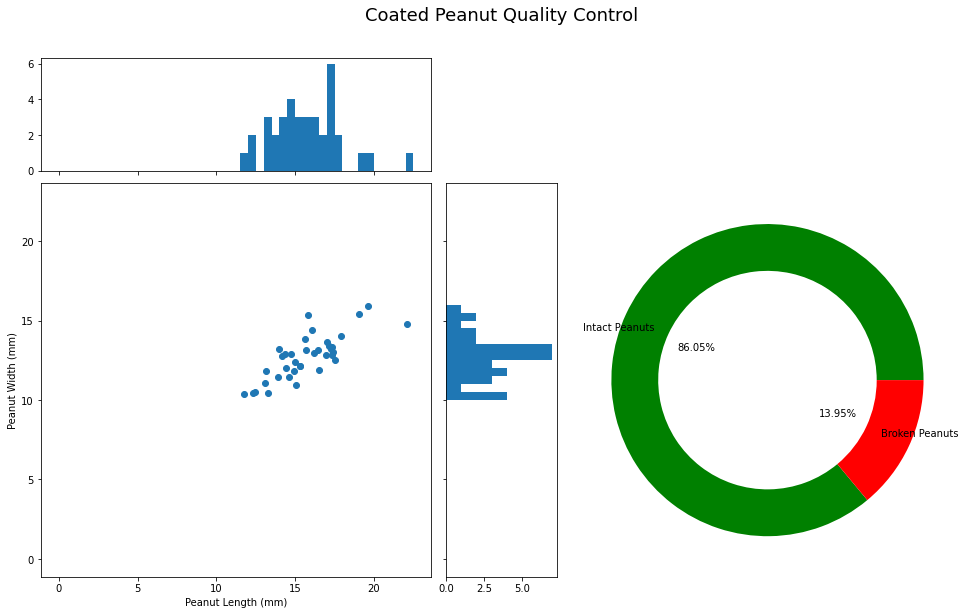

In [ ]:
# Test our function.
plot_results(nb_peanuts, nb_broken_peanuts, peanut_dim_list)